In [9]:
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

In [10]:
track_data = pd.read_csv('data.csv')
numerical_features = ["danceability","energy","loudness","speechiness","acousticness","instrumentalness","liveness","valence", "tempo","popularity"]
other_features = ["year","release_date","mode","key","explicit","id","duration_ms","artists","name"]
numerical_track_data = track_data[numerical_features]
numerical_track_data.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity
0,0.598,0.224,-12.628,0.0936,0.991000,0.000522,0.3790,0.6340,149.976,12
1,0.852,0.517,-7.261,0.0534,0.643000,0.026400,0.0809,0.9500,86.889,7
2,0.647,0.186,-12.098,0.1740,0.993000,0.000018,0.5190,0.6890,97.600,4
3,0.730,0.798,-7.311,0.0425,0.000173,0.801000,0.1280,0.0422,127.997,17
4,0.704,0.707,-6.036,0.0768,0.295000,0.000246,0.4020,0.2990,122.076,2


In [11]:
track_data.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,11m7laMUgmOKqI3oYzuhne,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,19Lc5SfJJ5O1oaxY0fpwfh,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,2hJjbsLCytGsnAHfdsLejp,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


In [12]:
track_np = np.array(numerical_track_data.values)
print(track_np)

[[  0.598   0.224 -12.628 ...   0.634 149.976  12.   ]
 [  0.852   0.517  -7.261 ...   0.95   86.889   7.   ]
 [  0.647   0.186 -12.098 ...   0.689  97.6     4.   ]
 ...
 [  0.671   0.589 -12.393 ...   0.714 108.058   0.   ]
 [  0.462   0.24  -12.077 ...   0.32  171.319  69.   ]
 [  0.677   0.46  -12.237 ...   0.747 112.208   0.   ]]


In [13]:
from sklearn.preprocessing import MinMaxScaler

minMaxScaler = MinMaxScaler().fit(track_np)
track_np = minMaxScaler.transform(track_np)

print(track_np)

[[0.60526316 0.224      0.7418683  ... 0.634      0.61590016 0.12      ]
 [0.86234818 0.517      0.8259181  ... 0.95       0.35682342 0.07      ]
 [0.6548583  0.186      0.75016835 ... 0.689      0.40080983 0.04      ]
 ...
 [0.6791498  0.589      0.74554851 ... 0.714      0.44375726 0.        ]
 [0.46761134 0.24       0.75049722 ... 0.32       0.70354856 0.69      ]
 [0.68522267 0.46       0.74799154 ... 0.747      0.46079989 0.        ]]


In [14]:
track_data_normalized = pd.DataFrame(track_np,columns=numerical_features,index=track_data.index)
track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02


In [15]:
for feature in other_features:
    track_data_normalized[feature] = track_data[feature]
track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,year,release_date,mode,key,explicit,id,duration_ms,artists,name
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12,1920,1920,0,5,0,0cS0A1fUEUd1EW3FcF8AEI,168333,['Mamie Smith'],Keep A Song In Your Soul
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07,1920,1920-01-05,0,5,0,0hbkKFIJm7Z05H8Zl9w30f,150200,"[""Screamin' Jay Hawkins""]",I Put A Spell On You
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04,1920,1920,1,0,0,11m7laMUgmOKqI3oYzuhne,163827,['Mamie Smith'],Golfing Papa
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17,1920,1920-01-01,1,2,0,19Lc5SfJJ5O1oaxY0fpwfh,422087,['Oscar Velazquez'],True House Music - Xavier Santos & Carlos Gomi...
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02,1920,1920-10-01,0,10,1,2hJjbsLCytGsnAHfdsLejp,165224,['Mixe'],Xuniverxe


## Process data to show songs distances

### Clusterisation

In [16]:
from sklearn.cluster import KMeans
n_clusters = 4
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(track_np)

In [17]:
kmeans_cluster_labels = kmeans.labels_
print(kmeans_cluster_labels)

[0 0 0 ... 3 0 1]


In [18]:
kmeans_cluster_centers = kmeans.cluster_centers_
print(kmeans_cluster_centers)

[[0.52533174 0.30323359 0.72393348 0.15133864 0.79476618 0.03050411
  0.2172609  0.4957489  0.46098032 0.18616228]
 [0.55912503 0.73700135 0.79403909 0.06884875 0.09072975 0.74828679
  0.22120807 0.45738015 0.51867592 0.17625195]
 [0.59806195 0.6853751  0.81005846 0.09495108 0.16731743 0.02011622
  0.21310917 0.61128105 0.5058254  0.38375235]
 [0.42626988 0.2258393  0.66147936 0.06423929 0.9255001  0.81332134
  0.1851833  0.38851602 0.43791653 0.1195667 ]]


In [19]:
track_data_normalized["kmeans_cluster"] = kmeans_cluster_labels
track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,year,release_date,mode,key,explicit,id,duration_ms,artists,name,kmeans_cluster
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12,1920,1920,0,5,0,0cS0A1fUEUd1EW3FcF8AEI,168333,['Mamie Smith'],Keep A Song In Your Soul,0
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07,1920,1920-01-05,0,5,0,0hbkKFIJm7Z05H8Zl9w30f,150200,"[""Screamin' Jay Hawkins""]",I Put A Spell On You,0
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04,1920,1920,1,0,0,11m7laMUgmOKqI3oYzuhne,163827,['Mamie Smith'],Golfing Papa,0
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17,1920,1920-01-01,1,2,0,19Lc5SfJJ5O1oaxY0fpwfh,422087,['Oscar Velazquez'],True House Music - Xavier Santos & Carlos Gomi...,1
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02,1920,1920-10-01,0,10,1,2hJjbsLCytGsnAHfdsLejp,165224,['Mixe'],Xuniverxe,2


In [44]:
# sub-clusterisation : each cluster is divided into small clusters 
n_sub_clusters = 10 
track_data_normalized["kmeans_subcluster"] = 0

for i in range(n_clusters):
    num_track_data_np = np.array(track_data_normalized[track_data_normalized["kmeans_cluster"]==i][numerical_features])

    subkmeans = KMeans(n_clusters=n_sub_clusters, random_state=0).fit(num_track_data_np)

    track_data_normalized.loc[track_data_normalized["kmeans_cluster"]==i,"kmeans_subcluster"] = subkmeans.labels_

track_data_normalized.head()

[3 8 3 ... 6 6 4]
Cluster :  0
[2 5 1 ... 3 2 3]
Cluster :  1
[1 4 1 ... 1 1 1]
Cluster :  2
[0 0 2 ... 3 1 9]
Cluster :  3


,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,...,release_date,mode,key,explicit,id,duration_ms,artists,name,kmeans_cluster,kmeans_subcluster
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12,...,1920,0,5,0,0cS0A1fUEUd1EW3FcF8AEI,168333,['Mamie Smith'],Keep A Song In Your Soul,0,3
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07,...,1920-01-05,0,5,0,0hbkKFIJm7Z05H8Zl9w30f,150200,"[""Screamin' Jay Hawkins""]",I Put A Spell On You,0,8
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04,...,1920,1,0,0,11m7laMUgmOKqI3oYzuhne,163827,['Mamie Smith'],Golfing Papa,0,3
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17,...,1920-01-01,1,2,0,19Lc5SfJJ5O1oaxY0fpwfh,422087,['Oscar Velazquez'],True House Music - Xavier Santos & Carlos Gomi...,1,2
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02,...,1920-10-01,0,10,1,2hJjbsLCytGsnAHfdsLejp,165224,['Mixe'],Xuniverxe,2,1


### Dimension reduction with PCA

In [45]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(track_np)
print(pca.components_)
print(pca.explained_variance_ratio_)

[[-0.14336327 -0.47591952 -0.1299825  -0.00323896  0.72027875  0.33417324
  -0.02218354 -0.21700919 -0.06857046 -0.23082766]
 [-0.13168511  0.22782645  0.00840301 -0.13102916 -0.35662635  0.85038369
  -0.00090589 -0.24556718  0.02302838 -0.04843285]]
[0.40860506 0.1845963 ]


In [46]:
# print(np.sum(pca.explained_variance_ratio_))
print(pca.explained_variance_)

[0.23393994 0.1056875 ]


In [47]:
print(numerical_features)

['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'popularity']


In [48]:
track_np_pca = pca.transform(track_np)

In [49]:
track_data_normalized["x"] = track_np_pca[:,0]
track_data_normalized["y"] = track_np_pca[:,1]
track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,...,key,explicit,id,duration_ms,artists,name,kmeans_cluster,kmeans_subcluster,x,y
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12,...,5,0,0cS0A1fUEUd1EW3FcF8AEI,168333,['Mamie Smith'],Keep A Song In Your Soul,0,3,0.400807,-0.426247
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07,...,5,0,0hbkKFIJm7Z05H8Zl9w30f,150200,"[""Screamin' Jay Hawkins""]",I Put A Spell On You,0,8,-0.061956,-0.321481
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04,...,0,0,11m7laMUgmOKqI3oYzuhne,163827,['Mamie Smith'],Golfing Papa,0,3,0.429887,-0.468072
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17,...,2,0,19Lc5SfJJ5O1oaxY0fpwfh,422087,['Oscar Velazquez'],True House Music - Xavier Santos & Carlos Gomi...,1,2,-0.222574,0.871068
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02,...,10,1,2hJjbsLCytGsnAHfdsLejp,165224,['Mixe'],Xuniverxe,2,1,-0.258098,0.006222


In [51]:
cluster_centers_pca = pca.transform(kmeans_cluster_centers)
print(cluster_centers_pca)

[[ 0.27146116 -0.28079781]
 [-0.20933597  0.69766936]
 [-0.46091948 -0.01717444]
 [ 0.72759364  0.37363053]]


In [52]:
def comput_dist(x,y,cluster):
    return 1000*np.sqrt((x-cluster_centers_pca[cluster][0])**2 + (y-cluster_centers_pca[cluster][1])**2)

track_data_normalized["dist"] = track_data_normalized.apply(lambda x: comput_dist(x['x'],x['y'],x['kmeans_cluster']), axis=1)

track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,...,explicit,id,duration_ms,artists,name,kmeans_cluster,kmeans_subcluster,x,y,dist
0,0.605263,0.224,0.741868,0.096395,0.994980,0.000522,0.3790,0.6340,0.615900,0.12,...,0,0cS0A1fUEUd1EW3FcF8AEI,168333,['Mamie Smith'],Keep A Song In Your Soul,0,3,0.400807,-0.426247,194.643434
1,0.862348,0.517,0.825918,0.054995,0.645582,0.026400,0.0809,0.9500,0.356823,0.07,...,0,0hbkKFIJm7Z05H8Zl9w30f,150200,"[""Screamin' Jay Hawkins""]",I Put A Spell On You,0,8,-0.061956,-0.321481,335.889981
2,0.654858,0.186,0.750168,0.179197,0.996988,0.000018,0.5190,0.6890,0.400810,0.04,...,0,11m7laMUgmOKqI3oYzuhne,163827,['Mamie Smith'],Golfing Papa,0,3,0.429887,-0.468072,245.296457
3,0.738866,0.798,0.825135,0.043769,0.000174,0.801000,0.1280,0.0422,0.525640,0.17,...,0,19Lc5SfJJ5O1oaxY0fpwfh,422087,['Oscar Velazquez'],True House Music - Xavier Santos & Carlos Gomi...,1,2,-0.222574,0.871068,173.903258
4,0.712551,0.707,0.845102,0.079094,0.296185,0.000246,0.4020,0.2990,0.501324,0.02,...,1,2hJjbsLCytGsnAHfdsLejp,165224,['Mixe'],Xuniverxe,2,1,-0.258098,0.006222,204.166721


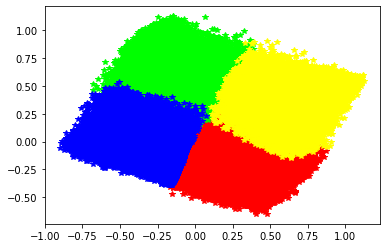

In [53]:
colors = ["#FF0000","#00FF00","#0000FF","#FFFF00","#00FFFF","#000000","#AA4422",
"#2244AA","#4422AA","#22AA44","#44AA22","#AAFF88"]
plt.figure()
for i in range(n_clusters):
    plt.plot(track_data_normalized[track_data_normalized["kmeans_cluster"]==i]["x"],track_data_normalized[track_data_normalized["kmeans_cluster"]==i]["y"],"*",color=colors[i])
plt.show()

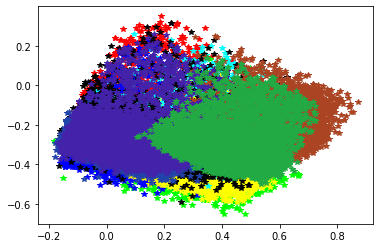

In [54]:
colors = ["#FF0000","#00FF00","#0000FF","#FFFF00","#00FFFF","#000000","#AA4422",
"#2244AA","#4422AA","#22AA44","#44AA22","#AAFF88"]
plt.figure()
for i in range(n_sub_clusters):
    plt.plot(track_data_normalized[track_data_normalized["kmeans_cluster"]==0][track_data_normalized["kmeans_subcluster"]==i]["x"],track_data_normalized[track_data_normalized["kmeans_cluster"]==0][track_data_normalized["kmeans_subcluster"]==i]["y"],"*",color=colors[i])
plt.show()

In [ ]:
# track_data_normalized.T.to_json('track_data_normalized.json')
write = False
if write :
    folder = "track_data_normalized"
    bag_size = track_data_normalized.shape[0]//10
    for i in range(track_data_normalized.shape[0]%10):
        track_data_normalized[i*bag_size:(i+1)*bag_size].T.to_json(folder + '/track_data_normalized' +  str(i) +'.json')

    track_data_normalized[(i+1)*bag_size:].T.to_json(folder + '/track_data_normalized' +  str(i+1) +'.json')


In [55]:
track_data_subsample = track_data_normalized.sample(frac=0.005, random_state=1).reset_index(drop=True)
track_data_subsample.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,...,explicit,id,duration_ms,artists,name,kmeans_cluster,kmeans_subcluster,x,y,dist
0,0.214575,0.0473,0.503829,0.041195,0.912651,0.927000,0.0958,0.248,0.453326,0.00,...,0,0z2yPL7Kb5PMuaDiCHCPds,70453,"['Christoph Willibald Gluck', 'Arturo Toscanini']","Orfeo ed Euridice, Wq. 30: Act II: Scene 2 - D...",3,3,0.951232,0.504512,259.121550
1,0.726721,0.1580,0.662454,0.968074,0.848394,0.000007,0.2410,0.436,0.476750,0.00,...,1,65AenIAuelcSNMaHFLpiZC,104000,['Трумен Капоте'],"Часть 9.3 - Другие голоса, другие комнаты",0,1,0.399819,-0.468968,227.780131
2,0.734818,0.0983,0.660496,0.043872,0.636546,0.000000,0.0746,0.347,0.437864,0.00,...,0,0VX9t9QCUvLV9KpSwmfBkA,218058,['Adam Gardner'],Portobello Market (2008),0,9,0.303399,-0.265899,35.242260
3,0.792510,0.4960,0.735401,0.037384,0.394578,0.624000,0.0875,0.909,0.452106,0.37,...,0,4CgRjwN2crlsHcU7ooFGmq,387640,['Shakatak'],Bitch to the Boys,1,3,-0.078249,0.279909,437.844246
4,0.728745,0.1840,0.614596,0.937178,0.421687,0.000000,0.1750,0.344,0.471186,0.01,...,0,4WqutZVrpv3YbICpHtcRMY,126316,"['Georgette Heyer', 'Irina Salkow']",Kapitel 369 - Der Page und die Herzogin,0,7,0.105628,-0.285456,165.898178


In [56]:
track_data_subsample.shape

(872, 24)

In [57]:
tree_json = {"name":"songs","children":[]}
for i in range(n_clusters):
    tree_json["children"].append({"name":"Cluster "+str(i), "children":[]})
    for j in range(n_sub_clusters):
        tree_json["children"][i]["children"].append({"name":"Sub-cluster "+str(i), "children":[]})

for i in range(track_data_subsample.shape[0]):
    tree_json["children"][track_data_subsample["kmeans_cluster"][i]]["children"][track_data_subsample["kmeans_subcluster"][i]]["children"].append({"name":track_data_subsample["name"][i],"value":track_data_subsample["dist"][i]})

In [58]:
import json
with open('tree_data.json', 'w') as outfile:
    json.dump(tree_json, outfile)

In [60]:
songs_df = track_data_subsample[["name","kmeans_cluster","kmeans_subcluster","x","y","dist"]]
songs_df.head()

,name,kmeans_cluster,kmeans_subcluster,x,y,dist
0,"Orfeo ed Euridice, Wq. 30: Act II: Scene 2 - D...",3,3,0.951232,0.504512,259.121550
1,"Часть 9.3 - Другие голоса, другие комнаты",0,1,0.399819,-0.468968,227.780131
2,Portobello Market (2008),0,9,0.303399,-0.265899,35.242260
3,Bitch to the Boys,1,3,-0.078249,0.279909,437.844246
4,Kapitel 369 - Der Page und die Herzogin,0,7,0.105628,-0.285456,165.898178


In [62]:
write_songs = False
if write_songs:
    songs_df.T.to_json('songs_json.json')

In [65]:
user_track_data = pd.read_json('user_track_data_normalized.json')
user_track_data = user_track_data.T
user_track_data.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,popularity,artist,album
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.302077,0.693878,"[David Guetta, Martin Garrix, Brooks]",Like I Do
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.275057,0.418367,"[Hayce Lemsi, Volts Face]",Comme dit maman
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.712189,0.581633,[Worakls],Salzburg
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.309532,0.489796,"[Vald, Suikon Blaz AD]",XEU
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.232582,0.632653,"[Heuss L'enfoiré, Sofiane]",En esprit


In [68]:
numerical_user_track_data = user_track_data[numerical_features]

user_track_np = np.array(numerical_user_track_data.values)

print(user_track_np)

[[0.6280576343000001 0.908997955 0.8726541143000001 ... 0.1398527865
  0.4544506607 0.693877551]
 [0.8034178488 0.7157464213 0.7951285438 ... 0.7181913775000001
  0.5624202076 0.4183673469]
 [0.864849771 0.3425357873 0.64155174 ... 0.4069400631
  0.44128951190000004 0.5816326531]
 ...
 [0.4627499162 0.3957055215 0.6827717542 ... 0.9337539432 0.59741857
  0.7244897959000001]
 [0.8938903161 0.7239263804 0.8041895752 ... 0.8843322818 0.2225296945
  0.7857142857]
 [0.6917234447 0.8251533742 0.8517369537 ... 0.41324921140000004
  0.24103818670000002 0.5306122449]]


In [74]:
user_cluster = kmeans.predict(user_track_np)
user_track_np_pca = pca.transform(user_track_np)

In [80]:
user_track_data_normalized = pd.DataFrame(user_track_np,columns=numerical_features,index=user_track_data.index)
user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653


In [81]:
for feature in ["duration_ms","artist","album"]:
    user_track_data_normalized[feature] = user_track_data[feature]
user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,duration_ms,artist,album
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878,0.302077,"[David Guetta, Martin Garrix, Brooks]",Like I Do
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367,0.275057,"[Hayce Lemsi, Volts Face]",Comme dit maman
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633,0.712189,[Worakls],Salzburg
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796,0.309532,"[Vald, Suikon Blaz AD]",XEU
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653,0.232582,"[Heuss L'enfoiré, Sofiane]",En esprit


In [82]:
user_track_data_normalized["kmeans_cluster"] = user_cluster
user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,duration_ms,artist,album,kmeans_cluster
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878,0.302077,"[David Guetta, Martin Garrix, Brooks]",Like I Do,2
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367,0.275057,"[Hayce Lemsi, Volts Face]",Comme dit maman,0
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633,0.712189,[Worakls],Salzburg,1
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796,0.309532,"[Vald, Suikon Blaz AD]",XEU,0
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653,0.232582,"[Heuss L'enfoiré, Sofiane]",En esprit,2


In [83]:
user_track_data_normalized["x"] = user_track_np_pca[:,0]
user_track_data_normalized["y"] = user_track_np_pca[:,1]
user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,duration_ms,artist,album,kmeans_cluster,x,y
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878,0.302077,"[David Guetta, Martin Garrix, Brooks]",Like I Do,2,-0.666409,0.192811
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367,0.275057,"[Hayce Lemsi, Volts Face]",Comme dit maman,0,-0.087815,-0.298268
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633,0.712189,[Worakls],Salzburg,1,-0.119432,0.746260
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796,0.309532,"[Vald, Suikon Blaz AD]",XEU,0,0.034952,-0.338967
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653,0.232582,"[Heuss L'enfoiré, Sofiane]",En esprit,2,-0.729323,-0.074605


In [84]:
user_track_data_normalized["dist"] = user_track_data_normalized.apply(lambda x: comput_dist(x['x'],x['y'],x['kmeans_cluster']), axis=1)

user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,duration_ms,artist,album,kmeans_cluster,x,y,dist
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878,0.302077,"[David Guetta, Martin Garrix, Brooks]",Like I Do,2,-0.666409,0.192811,293.802614
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367,0.275057,"[Hayce Lemsi, Volts Face]",Comme dit maman,0,-0.087815,-0.298268,359.700710
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633,0.712189,[Worakls],Salzburg,1,-0.119432,0.746260,102.195213
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796,0.309532,"[Vald, Suikon Blaz AD]",XEU,0,0.034952,-0.338967,243.556952
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653,0.232582,"[Heuss L'enfoiré, Sofiane]",En esprit,2,-0.729323,-0.074605,274.478749


In [86]:
user_track_data_normalized["name"] = user_track_data_normalized.index
user_track_data_normalized.head()

,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,popularity,duration_ms,artist,album,kmeans_cluster,x,y,dist,name
Like I Do,0.628058,0.908998,0.872654,0.0164069,0.00666801,0.0147808,0.376635,0.139853,0.454451,0.693878,0.302077,"[David Guetta, Martin Garrix, Brooks]",Like I Do,2,-0.666409,0.192811,293.802614,Like I Do
Comme dit maman,0.803418,0.715746,0.795129,0.0379702,0.797374,0,0.0845684,0.718191,0.56242,0.418367,0.275057,"[Hayce Lemsi, Volts Face]",Comme dit maman,0,-0.087815,-0.298268,359.700710,Comme dit maman
Salzburg,0.86485,0.342536,0.641552,0.0819173,0.00339172,0.93578,0.0501308,0.40694,0.44129,0.581633,0.712189,[Worakls],Salzburg,1,-0.119432,0.746260,102.195213,Salzburg
Offshore,0.834692,0.433538,0.705624,0.327317,0.729832,0,0.318875,0.518402,0.427901,0.489796,0.309532,"[Vald, Suikon Blaz AD]",XEU,0,0.034952,-0.338967,243.556952,Offshore
Khapta,0.82464,0.696319,0.899776,0.0952772,0.0094201,0,0.0385789,0.84122,0.434605,0.632653,0.232582,"[Heuss L'enfoiré, Sofiane]",En esprit,2,-0.729323,-0.074605,274.478749,Khapta


In [91]:
user_songs_df = user_track_data_normalized[["name","kmeans_cluster","x","y","dist"]]
user_songs_df.reset_index(drop=True)
user_songs_df.head()

user_songs_df.T.to_json("user_songs_df.json")